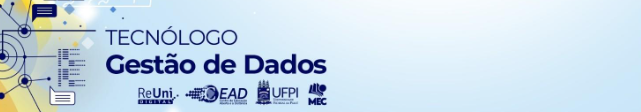

### UNIVERSIDADE FEDERAL DO PIAUÍ

 **Disciplina:** Tópicas Especias em Dados, Ciência, Tecnologia e Inovação (4º Período)

**Professora:** Patrícia Medyna | **Aluno:** Sérgio Fonte

**Projeto:** Classificador e identificador de equipe na Fórmula 1

---
# 📦 Importações, Funções e Instalações
---

## 🔩 Instalações

In [ ]:
!pip install tensorflow pillow imageio selenium webdriver_manager

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.4/9.4 MB 37.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 499.2/499.2 kB 24.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.8/45.8 kB 3.6 MB/s eta 0:00:00
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.14.0
    Uninstalling typing_extensions-4.14.0:
      Successfully uninstalled typing_extensions-4.14.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torch 2.6.0+cu124 requires nvidia-cublas-cu12==12.4.5.8; platform_system == "Linux" and platform_machine == "x86_64", but you have nvidia-cublas-cu12 12.5.3.2 which is incompatible.
torch 2.6.0+cu124 requires nvidia-cuda-cupti-cu12==12.4.127; platform_system == "Linux" and platform_machine == "x86_64", but you have nvidia-cuda-cupti-cu12 12.5.82 which is incompatible.
torch 2.6.0+cu124 r

## 🛬 Importações

In [ ]:
import re                         # Biblioteca para trabalhar com expressões regulares (manipulação e busca em textos)
import os                         # Fornece funções para interagir com o sistema operacional (criar pastas, listar arquivos, etc.)
import uuid                       # Geração de identificadores únicos (UUID)
import glob                       # Usado para buscar arquivos e diretórios com padrões (wildcards)
import time                       # Biblioteca para controle de tempo (delays, pausas)
import shutil                     # Permite operações de cópia, movimentação e remoção de arquivos e diretórios
import hashlib                    # Fornece funções para criar hashes (útil para garantir integridade de dados ou gerar IDs únicos)
import requests                   # Biblioteca para fazer requisições HTTP
import imageio                    # Biblioteca para ler e gravar imagens
import numpy as np                # Biblioteca para operações matemáticas e matrizes (vetores, arrays, etc.)
import seaborn as sns             # Biblioteca para visualização de dados baseada em matplotlib
import pandas as pd               # Biblioteca para manipulação e análise de dados
import tensorflow as tf           # Biblioteca de aprendizado de máquina e deep learning (Google)
import matplotlib.pyplot as plt   # Biblioteca para visualização de dados (gráficos, imagens, etc.)


from selenium import webdriver                            # Selenium para automação de navegador
from selenium.webdriver.chrome.service import Service
from selenium.webdriver.chrome.options import Options
from webdriver_manager.chrome import ChromeDriverManager  # Gerenciador do driver do Chrome


from PIL import Image                               # Biblioteca para manipulação de imagens (abertura, redimensionamento, etc.)
from pathlib import Path                            # Manejo de caminhos de arquivos de forma orientada a objetos
from bs4 import BeautifulSoup                       # Biblioteca para fazer parsing de HTML (web scraping)
from google.colab import drive                      # Permite montar o Google Drive no Colab para acesso aos arquivos
from urllib.parse import urljoin                    # Permite construir URLs completas a partir de URLs relativas
from typing import Dict, NoReturn                   # Anotações de tipo para maior legibilidade e verificação de tipos no código
from collections import defaultdict                 # Estrutura de dicionário com valor padrão automático (evita KeyError)
from tensorflow.keras.models import Model           # Classe base para criar modelos personalizados no Keras
from sklearn.metrics import confusion_matrix        # Gera a matriz de confusão
from tensorflow.keras.models import load_model      # Carregar modelos salvos no formato Keras (.h5, SavedModel, etc.)
from tensorflow.keras.preprocessing import image    # Utilitário do Keras para pré-processamento de imagens
from sklearn.metrics import classification_report
from tensorflow.keras.applications import MobileNetV2                      # Importa o modelo pré-treinado MobileNetV2
from tensorflow.keras.preprocessing.image import ImageDataGenerator        # Gerador de dados para aumento (data augmentation) e carregamento de imagens
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input    # Pré-processamento específico para MobileNetV2
from tensorflow.keras.preprocessing.image import load_img, img_to_array  # Carregar imagens e convertê-las em arrays NumPy
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping,ReduceLROnPlateau               # Callbacks para salvar o melhor modelo e interromper o treino quando não há melhoria
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, BatchNormalization        # Camadas da rede neural (fully connected e pooling global)



## 🧰 Funções

### Gera um relatório de conteúdo

In [ ]:
def gerar_relatorio_dados(dataset_dir: str) -> Dict[str, int]:
    """
    Gera e imprime um relatório com a contagem de itens (arquivos e pastas) para cada subpasta
    no diretório do dataset (independente de ser train, val, test ou outros).

    Parâmetros:
        dataset_dir (str): Caminho raiz onde estão as pastas por classe ou categorias.

    Retorna:
        dict: Um dicionário com a estrutura {subpasta: quantidade_de_itens}.
    """
    relatorio = {}

    for raiz, subdirs, _ in os.walk(dataset_dir):
        for subdir in subdirs:
            pasta = os.path.join(raiz, subdir)
            itens = os.listdir(pasta)  # Lista tudo dentro da pasta (arquivos e pastas)
            relatorio[subdir] = len(itens)

    # Exibe relatório formatado
    print("\n=== RELATÓRIO DE ITENS ===")
    contador_geral = 0
    for pasta, qtd in sorted(relatorio.items(), key=lambda x: x[0]):
        print(f" - {pasta}: {qtd} itens")
        contador_geral += qtd
    print(f"\nTotal Geral: {contador_geral} itens")

### Funções de extração de imagens

In [ ]:
def gerar_nome_unico(pasta, nome_arquivo):
    nome_base, extensao = os.path.splitext(nome_arquivo)
    contador = 1
    novo_nome = nome_arquivo
    while os.path.exists(os.path.join(pasta, novo_nome)):
        novo_nome = f"{nome_base}_{contador}{extensao}"
        contador += 1
    return novo_nome

def baixar_imagens(url, pasta_destino):
    if not os.path.exists(pasta_destino):
        os.makedirs(pasta_destino)

    try:
        resposta = requests.get(url)
        resposta.raise_for_status()
    except Exception as e:
        print(f"Erro ao acessar a URL: {e}")
        return

    soup = BeautifulSoup(resposta.text, "html.parser")
    imagens = soup.find_all("img")
    print(f"Encontradas {len(imagens)} imagens.")

    for i, img in enumerate(imagens):
        src = img.get("src")
        if not src:
            continue

        img_url = urljoin(url, src)
        nome_arquivo = os.path.basename(img_url.split("?")[0])
        if not nome_arquivo:
            nome_arquivo = f"imagem_{i}.jpg"

        nome_arquivo = gerar_nome_unico(pasta_destino, nome_arquivo)

        try:
            img_resposta = requests.get(img_url)
            img_resposta.raise_for_status()

            caminho_arquivo = os.path.join(pasta_destino, nome_arquivo)
            with open(caminho_arquivo, "wb") as f:
                f.write(img_resposta.content)
            print(f"[✔] Imagem salva: {caminho_arquivo}")
        except Exception as e:
            print(f"[✖] Erro ao baixar {img_url}: {e}")


In [ ]:
def baixar_imagens_tipo_2(url, pasta_destino, delay=6):
    """
    Faz web scraping e baixa imagens de uma página da web.

    Parâmetros:
    - url (str): URL da página para buscar as imagens.
    - pasta_destino (str): Caminho da pasta onde as imagens serão salvas.
    - delay (int): Tempo de espera para carregamento da página (default=6).

    Retorna:
    - Total de imagens salvas.
    """

    # Configurar opções do Chrome
    chrome_options = Options()
    chrome_options.add_argument("--headless")  # Executa sem abrir janela
    chrome_options.add_argument("--no-sandbox")
    chrome_options.add_argument("--disable-dev-shm-usage")

    # Iniciar o driver
    driver = webdriver.Chrome(service=Service(ChromeDriverManager().install()), options=chrome_options)

    try:
        # Acessar a URL
        driver.get(url)
        time.sleep(delay)  # Esperar carregar os elementos

        # Captura HTML e faz parsing
        html = driver.page_source
        soup = BeautifulSoup(html, 'html.parser')

        # Encontra todas as imagens
        imagens = soup.find_all('img')
        print(f'Encontradas {len(imagens)} imagens.')

        # Cria pasta destino se não existir
        os.makedirs(pasta_destino, exist_ok=True)

        # Baixar as imagens
        contador = 0
        for img in imagens:
            src = img.get('src')

            if src and (src.startswith('http')):
                nome_arquivo = img.get('alt') or f'imagem_{contador}.jpg'
                nome_arquivo = nome_arquivo.replace(' ', '_').replace('/', '_').replace('\\', '_')
                caminho = os.path.join(pasta_destino, nome_arquivo)

                try:
                    resposta = requests.get(src)
                    if resposta.status_code == 200:
                        with open(caminho, 'wb') as f:
                            f.write(resposta.content)
                        print(f'[✔] Salvo: {nome_arquivo}')
                        contador += 1
                    else:
                        print(f'[✖] Falha ao baixar {src}')
                except Exception as e:
                    print(f'[✖] Erro ao baixar {src}: {e}')

        print(f'Total de imagens salvas: {contador}')
        return contador

    finally:
        driver.quit()

### Tratamento de pré-processamento (conversão, exclusão e renomeamento)

In [ ]:
def converter_para_jpg(diretorio: str) -> NoReturn:
    """
    Converte todas as imagens em formatos suportados dentro do diretório (recursivamente)
    para o formato JPEG, removendo os arquivos originais após a conversão.
    Imagens que já estão no formato .jpg são ignoradas.

    Parâmetros:
        diretorio (str): Caminho para o diretório base contendo as imagens a serem convertidas.

    Retorno:
        None: A função atua diretamente nos arquivos e não retorna valor.
    """
    formatos_validos = ['*.webp', '*.jpeg', '*.png', '*.avif']
    imagens = 0
    for formato in formatos_validos:
        # Busca recursivamente por arquivos no formato atual
        for caminho_img in glob.glob(os.path.join(diretorio, '**', formato), recursive=True):
            try:
                # Ignora arquivos que já estão no formato .jpg (case insensitive)
                if caminho_img.lower().endswith('.jpg'):
                    continue

                # Abre a imagem e converte para RGB para garantir compatibilidade com JPEG
                img = Image.open(caminho_img).convert('RGB')

                # Gera o novo nome do arquivo com extensão .jpg
                novo_nome = os.path.splitext(caminho_img)[0] + '.jpg'

                # Salva a imagem convertida no novo arquivo JPEG
                img.save(novo_nome, 'JPEG')

                # Remove o arquivo original para evitar duplicatas
                os.remove(caminho_img)
                imagens += 1

            except Exception as e:
                print(f"[ERRO AO CONVERTER]: {caminho_img}: {e}")

    print(f"\nTotal de imagens convertidas: {imagens}\n")

In [ ]:
def excluir_nao_jpg(diretorio: str) -> NoReturn:
    """
    Exclui todos os arquivos que não possuem a extensão '.jpg' dentro do diretório
    especificado, incluindo subdiretórios.

    Parâmetros:
        diretorio (str): Caminho do diretório onde a limpeza será realizada.

    Retorno:
        None: A função atua diretamente nos arquivos e retorna um print de quantos foram excluídos.
    """
    excluido = 0

    for raiz, _, arquivos in os.walk(diretorio):
        for nome in arquivos:
            if not nome.lower().endswith('.jpg'):
                caminho_arquivo = os.path.join(raiz, nome)
                try:
                    os.remove(caminho_arquivo)
                    excluido += 1
                    print(f"[REMOVIDO - NÃO JPG]: {caminho_arquivo}")
                except Exception as e:
                    print(f"Erro ao remover {caminho_arquivo}: {e}")

    print(f"\nTotal de imagens excluídas por está fora do padrão: {excluido}")


In [ ]:
def remover_imagens_duplicadas(diretorio: str) -> None:
    """
    Remove imagens duplicadas em um diretório (e subdiretórios) com base no hash do conteúdo.

    Parâmetros:
        diretorio (str): Caminho para o diretório onde será feita a remoção.
    """
    hashes = {}
    removidos = 0

    for raiz, _, arquivos in os.walk(diretorio):
        for nome in arquivos:
            if nome.lower().endswith('.jpg'):
                caminho_arquivo = os.path.join(raiz, nome)
                try:
                    # Abre e calcula hash da imagem
                    with Image.open(caminho_arquivo) as img:
                        # Redimensiona para acelerar o hash e ignora metadados
                        img = img.convert('RGB')
                        hash_imagem = hashlib.md5(img.tobytes()).hexdigest()

                    if hash_imagem in hashes:
                        # Arquivo duplicado encontrado, remove
                        os.remove(caminho_arquivo)
                        removidos += 1
                        print(f"[REMOVIDO - IMG DUPLICADA] {caminho_arquivo} (duplicado de {hashes[hash_imagem]})")
                    else:
                        hashes[hash_imagem] = caminho_arquivo

                except Exception as e:
                    print(f"[ERRO] Erro ao processar {caminho_arquivo}: {e}")

    print(f"\nTotal de imagens removidas por duplicidade: {removidos}\n")

In [ ]:
def renomear_imagens(diretorio: str) -> NoReturn:
    """
    Renomeia todas as imagens .jpg em um diretório (e subdiretórios) com nomes únicos usando UUID,
    somente se ainda não tiverem sido renomeadas (não tiverem UUID no nome).

    Parâmetros:
        diretorio (str): Caminho para o diretório onde as imagens devem ser renomeadas.

    Retorno:
        None: A função executa operações diretamente nos arquivos e retorna quantidade de imagens renomeadas.
    """
    # Regex para detectar UUID no nome do arquivo
    padrao_uuid = re.compile(r"^[0-9a-fA-F]{8}-[0-9a-fA-F]{4}-"
                             r"[0-9a-fA-F]{4}-[0-9a-fA-F]{4}-"
                             r"[0-9a-fA-F]{12}\.jpg$")

    renomeados = 0

    for raiz, _, arquivos in os.walk(diretorio):
        for nome in arquivos:
            if nome.lower().endswith('.jpg') and not padrao_uuid.match(nome):
                caminho_antigo = os.path.join(raiz, nome)

                # Gera um nome novo e único para a imagem
                novo_nome = f"{uuid.uuid4()}.jpg"
                caminho_novo = os.path.join(raiz, novo_nome)

                # Renomeia a imagem
                os.rename(caminho_antigo, caminho_novo)
                renomeados += 1

    print(f"\nTotal de imagens renomeadas: {renomeados}\n")


### Funções de Treinamento

In [ ]:
def criar_generators_com_augmentation(base_dir: str, img_size: tuple, batch_size: int, val_split: float = 0.2):
    """
    Cria os geradores de dados para treino e validação usando uma única pasta base.
    As imagens são divididas automaticamente entre treino e validação.

    Parâmetros:
        base_dir (str): Caminho da pasta com subpastas de cada equipe.
        img_size (tuple): Tamanho para redimensionamento das imagens.
        batch_size (int): Tamanho do lote.
        val_split (float): Proporção de dados para validação (padrão 20%).

    Retorna:
        train_gen, val_gen: Geradores para treino e validação.
    """
    train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=10,             # Aumenta rotação
    width_shift_range=0.2,         # Deslocamento horizontal
    height_shift_range=0.2,        # Deslocamento vertical
    shear_range=0.2,               # Cisalhamento (inclinação)
    horizontal_flip=True,          # Espelhamento
    brightness_range=[0.9,1.1],    # Variação de brilho
    validation_split=val_split
    )


    train_gen = train_datagen.flow_from_directory(
    base_dir,                            # Pasta onde estão as subpastas de classes
    target_size=img_size,                # Redimensiona cada imagem
    batch_size=batch_size,               # Tamanho do lote
    class_mode='categorical',            # Saída das classes em one-hot (vetor com 1 na classe correta)
    subset='training',                   # Usa somente os dados de treino (80%)
    shuffle=True                         # Embaralha as imagens a cada época
    )

    val_gen = train_datagen.flow_from_directory(
    base_dir,
    target_size=img_size,
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation',                 # Usa somente os dados de validação (20%)
    shuffle=False                        # NÃO embaralha (útil para relatórios e métricas)
    )

    return train_gen, val_gen


✅ Quando usar val_accuracy
Use val_accuracy quando o conjunto de validação for grande e balanceado, e você quer apenas a melhor acurácia final. Porém, isso não garante que o modelo não esteja superajustando.

✅ Quando usar val_loss (o que fizemos)
Use val_loss quando deseja parar o treinamento assim que o modelo parar de aprender de fato, mesmo que a acurácia varie pouco. Isso é útil porque:

val_loss é mais sensível a mudanças no desempenho do modelo — melhora mesmo quando a acurácia continua igual.

Evita que o modelo continue treinando após atingir o mínimo de perda — ajuda a evitar overfitting.

Em classificações com múltiplas classes e probabilidades suaves (como no softmax), o val_loss dá uma visão mais refinada do quanto o modelo está confiante (e correto) nas previsões.

In [ ]:
def criar_generators_sem_augmentation(base_dir: str, img_size: tuple, batch_size: int, val_split: float = 0.2):
    """
    Cria os geradores de dados para treino e validação sem data augmentation.
    """
    datagen = ImageDataGenerator(
        rescale=1./255,
        validation_split=val_split
    )
    SEED = 42

    train_gen = datagen.flow_from_directory(
        base_dir,
        target_size=img_size,
        batch_size=batch_size,
        class_mode='categorical',
        subset='training',
        shuffle=True,
        seed=SEED
    )

    val_gen = datagen.flow_from_directory(
        base_dir,
        target_size=img_size,
        batch_size=batch_size,
        class_mode='categorical',
        subset='validation',
        shuffle=False,
        seed=SEED
    )

    return train_gen, val_gen


In [ ]:
def criar_modelo(num_classes: int, img_size: tuple):
    """
    Cria o modelo baseado no MobileNetV2 com camadas finais customizadas para classificação.
    """
    base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(*img_size, 3))
    base_model.trainable = False

    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = BatchNormalization()(x)
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.4)(x)  # Regularização
    output = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=base_model.input, outputs=output)
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

    return model


In [ ]:
def treinar_modelo(model: Model, train_gen, val_gen, epochs: int, checkpoint_path: str):
    """
    Treina o modelo com callbacks para salvar o melhor modelo e early stopping.
    """
    checkpoint = ModelCheckpoint(
        checkpoint_path,
        monitor='val_loss',
        save_best_only=True,
        verbose=1
    )

    earlystop = EarlyStopping(
        monitor='val_loss',
        patience=3,
        verbose=1,
        restore_best_weights=True
    )

    reduce_lr = ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.2,
        patience=2,
        verbose=1,
        min_lr=1e-6
    )

    history = model.fit(
        train_gen,
        validation_data=val_gen,
        epochs=epochs,
        callbacks=[checkpoint, earlystop, reduce_lr]
    )
    return history

In [ ]:
def plotar_historico(history, titulo=None):
    """
    Plota gráficos de perda e acurácia do treino, com linhas horizontais de referência
    e rótulos nos pontos finais deslocados. Legenda no canto superior direito.
    """
    plt.figure(figsize=(12, 5))

    if titulo:
        plt.suptitle(titulo, fontsize=16)

    epochs = range(1, len(history.history['loss']) + 1)

    # Perda
    ax1 = plt.subplot(1, 2, 1)
    ax1.plot(epochs, history.history['loss'], color='blue', linestyle='--', label='Treino')
    ax1.plot(epochs, history.history['val_loss'], color='green', label='Validação')
    ax1.set_title('Perda')
    ax1.set_xlabel('Época')
    ax1.set_ylabel('Perda')
    ax1.set_ylim(0, 3)
    ax1.set_xlim(1, epochs[-1] + 1)
    ax1.text(epochs[-1] + 0.5, history.history['loss'][-1] - 0.02,
             f"{history.history['loss'][-1]:.2f}", color='blue')
    ax1.text(epochs[-1] + 0.5, history.history['val_loss'][-1] - 0.02,
             f"{history.history['val_loss'][-1]:.2f}", color='green')
    # Remove bordas
    for spine in ax1.spines.values():
        spine.set_visible(False)

    # Acurácia
    ax2 = plt.subplot(1, 2, 2)
    ax2.plot(epochs, history.history['accuracy'], color='blue',linestyle='--', label='Treino')
    ax2.plot(epochs, history.history['val_accuracy'], color='green',label='Validação')
    ax2.set_title('Acurácia')
    ax2.set_xlabel('Época')
    ax2.set_ylabel('Acurácia')
    ax2.set_ylim(0, 1.2)
    ax2.set_xlim(1, epochs[-1] + 1)
    ax2.text(epochs[-1] + 0.5, history.history['accuracy'][-1] - 0.02,
             f"{history.history['accuracy'][-1]:.2f}", color='blue')
    ax2.text(epochs[-1] + 0.5, history.history['val_accuracy'][-1] - 0.02,
             f"{history.history['val_accuracy'][-1]:.2f}", color='green')
    ax2.legend(loc='upper right', bbox_to_anchor=(1.3, 1))
    # Remove bordas
    for spine in ax2.spines.values():
        spine.set_visible(False)

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

### Funções de Classificação

In [ ]:
def obter_classes(caminho_classes: Path):
    """Obtém nomes de classes a partir das subpastas de um diretório."""
    classes = [p.name for p in caminho_classes.iterdir() if p.is_dir()]
    classes.sort()  # ordena para manter padrão consistente
    return classes

In [ ]:
def preparar_imagem(caminho_img: Path):
    """Carrega e prepara a imagem para predição."""
    img = load_img(str(caminho_img), target_size=IMG_SIZE)
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = preprocess_input(img_array)
    return img_array

In [ ]:
def classificar_e_mover(modelo, class_names, caminho_imagem, caminho_saida, mostrar_imagem=True):
    """Classifica a imagem, cria pasta destino e move o arquivo."""
    try:
        if mostrar_imagem:
            img_display = Image.open(caminho_imagem)
            plt.imshow(img_display)
            plt.title(f"Imagem: {caminho_imagem.name}")
            plt.axis('off')
            plt.show()

        img_array = preparar_imagem(caminho_imagem)
        predicao = modelo.predict(img_array)
        indice_classe = np.argmax(predicao)
        nome_classe = class_names[indice_classe]

        pasta_destino = caminho_saida / nome_classe
        pasta_destino.mkdir(parents=True, exist_ok=True)

        destino_final = pasta_destino / caminho_imagem.name

        if destino_final.exists():
            print(f"Arquivo {destino_final} já existe, pulando...")
            return nome_classe  # retorna para imprimir fora a classificação

        shutil.move(str(caminho_imagem), str(destino_final))
        print(f"{caminho_imagem.name} → {nome_classe}")
        return nome_classe
    except Exception as e:
        print(f"Erro ao processar {caminho_imagem.name}: {e}")
        return None


---
# 📂 Extração de Arquivos
---

In [ ]:
# Montar Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


## 🤖 Extração por webscrappig para classificar manualmente

### Forma Simplificada

In [ ]:
# Caminho para salvar os arquivos
#pasta_destino = '/content/drive/MyDrive/4º Período/Tópicos Especiais - Visão Computacional/Projeto - VC/web_scrapping_f1'

# Solicita o link para baixar todas imagens
#link = input("Digite a URL do site: ")

# Função para pegar todas imagens do link de forma mais simples
#baixar_imagens(link, pasta_destino)


### Forma Complexa

In [ ]:
# Caminho para salvar os arquivos
#pasta_destino = '/content/drive/MyDrive/4º Período/Projeto - VC/web_scrapping_f1'

# Solicita o link para baixar todas imagens
#url = 'https://www.shutterstock.com/search/azerbaijan-grand-prix'

# Função para pegar todas imagens do link de forma mais simples
#baixar_imagens_tipo_2(url, pasta_destino)

## 💾 Armazenamento Próprio

In [ ]:
# Definir diretórios do dataset
base_dir = '/content/drive/MyDrive/4º Período/Tópicos Especiais - Visão Computacional/Projeto - VC'
base_imagens = '/content/drive/MyDrive/4º Período/Tópicos Especiais - Visão Computacional/Projeto - VC/imagens_equipes'

## 🧾 Report de Itens

In [ ]:
# Gerar relatório de imagens pré processamento
gerar_relatorio_dados(base_imagens)


=== RELATÓRIO DE ITENS ===
 - alpine: 242 itens
 - aston_martin: 250 itens
 - ferrari: 223 itens
 - haas: 152 itens
 - mclaren: 228 itens
 - mercedes: 208 itens
 - racing_bulls: 189 itens
 - redbull: 187 itens
 - sauber: 169 itens
 - willians: 171 itens

Total Geral: 2019 itens


---
# 💊 Pré-processamento

Converte as imagens para um padrão único (.jpg), remove imagens duplicadas, renomeia os arquivos no padrão `uuid` e gera um relatório de quantidade de arquivos em cada pasta.

---

In [ ]:
# Converte todas as imagens para .jpg
converter_para_jpg(base_imagens)

# Remove arquivos que não sejam .jpg, garantindo padronização
excluir_nao_jpg(base_imagens)

# Remove imagens duplicadas por conteúdo (hash)
#remover_imagens_duplicadas(base_imagens)

# Renomeia as imagens com UUID para evitar colisões
renomear_imagens(base_imagens)


Total de imagens convertidas: 0


Total de imagens excluídas por está fora do padrão: 0

Total de imagens renomeadas: 0



In [ ]:
# Gerar relatório de imagens pós-processamento
gerar_relatorio_dados(base_imagens)


=== RELATÓRIO DE ITENS ===
 - alpine: 242 itens
 - aston_martin: 250 itens
 - ferrari: 223 itens
 - haas: 152 itens
 - mclaren: 228 itens
 - mercedes: 208 itens
 - racing_bulls: 189 itens
 - redbull: 187 itens
 - sauber: 169 itens
 - willians: 171 itens

Total Geral: 2019 itens


---

# 💪 Treinamento do Modelo
Avaliar imagens e treinar modelo para identificar e classificar imagens, vamos testar futuramente uma forma de multiplicar as imagens do banco.

---


In [ ]:
# Hiperparâmetros
BASE_DIR = base_imagens
IMG_SIZE = (224, 224)
BATCH_SIZE = 40
EPOCHS = 50
VAL_SPLIT = 0.2  # 20% dos dados para validação

### Sem data Augmentation

In [ ]:
# Geradores SEM data augmentation
#train_gen_sem_aug, val_gen_sem_aug = criar_generators_sem_augmentation(BASE_DIR, IMG_SIZE, BATCH_SIZE, VAL_SPLIT)

# Número de classes (equipes)
#NUM_CLASSES = len(train_gen_sem_aug.class_indices)

# Modelo SEM augmentation
#model_sem_aug = criar_modelo(NUM_CLASSES, IMG_SIZE)

# Caminho para salvar o melhor modelo
#CHECKPOINT_PATH_SEM_AUG = '/content/drive/MyDrive/melhor_modelo_sem_aug.keras'

# Treino SEM augmentation
#history_sem_aug = treinar_modelo(model_sem_aug, train_gen_sem_aug, val_gen_sem_aug, EPOCHS, CHECKPOINT_PATH_SEM_AUG)

### Com Data Augmentation

In [ ]:
# Geradores COM data augmentation
train_gen_com_aug, val_gen_com_aug = criar_generators_com_augmentation(BASE_DIR, IMG_SIZE, BATCH_SIZE, VAL_SPLIT)

# Número de classes (equipes)
NUM_CLASSES = len(train_gen_com_aug.class_indices)

# Modelo COM augmentation
model_com_aug = criar_modelo(NUM_CLASSES, IMG_SIZE)

CHECKPOINT_PATH_COM_AUG = '/content/drive/MyDrive/4º Período/Tópicos Especiais - Visão Computacional/Projeto - VC/melhor_modelo_f1.keras'

# Treino COM augmentation
history_com_aug = treinar_modelo(model_com_aug, train_gen_com_aug, val_gen_com_aug, EPOCHS, CHECKPOINT_PATH_COM_AUG)

Found 1620 images belonging to 10 classes.
Found 399 images belonging to 10 classes.
9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/50
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 10s/step - accuracy: 0.1773 - loss: 2.7653
Epoch 1: val_loss improved from inf to 1.62700, saving model to /content/drive/MyDrive/4º Período/Tópicos Especiais - Visão Computacional/Projeto - VC/melhor_modelo_f1.keras
41/41 ━━━━━━━━━━━━━━━━━━━━ 513s 12s/step - accuracy: 0.1794 - loss: 2.7548 - val_accuracy: 0.4662 - val_loss: 1.6270 - learning_rate: 0.0010
Epoch 2/50
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 891ms/step - accuracy: 0.4709 - loss: 1.4878
Epoch 2: val_loss improved from 1.62700 to 1.31276, saving model to /content/drive/MyDrive/4º Período/Tópicos Especiais - Visão Computacional/Projeto - VC/melhor_modelo_f1.keras
41/41 ━━━━━━━━━━━━━━━━━━━━ 46s 1s/step - accuracy: 0.4719 - loss: 1.4861 - val_accuracy: 0.5890 - val_loss: 1.3128 - learning_rate: 0.0010
Epoch 3/50
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 878ms/step - accuracy: 0.6076 - loss: 1.1179
Epoch 3: val_loss improved from 1.31276 to 1.14539, saving model to /content/drive/MyDrive/4º Período/Tó

## Plote de informações

### Histórico de Perda e Acurácia

**Objetivo:**  Avaliar o desempenho do modelo durante o treinamento, tanto no conjunto de treino quanto no de validação, observando:
1. Se o modelo está aprendendo (reduzindo a perda e aumentando a acurácia no treino).
2. Se o modelo está generalizando bem para dados novos (validação) ou sofrendo de overfitting.



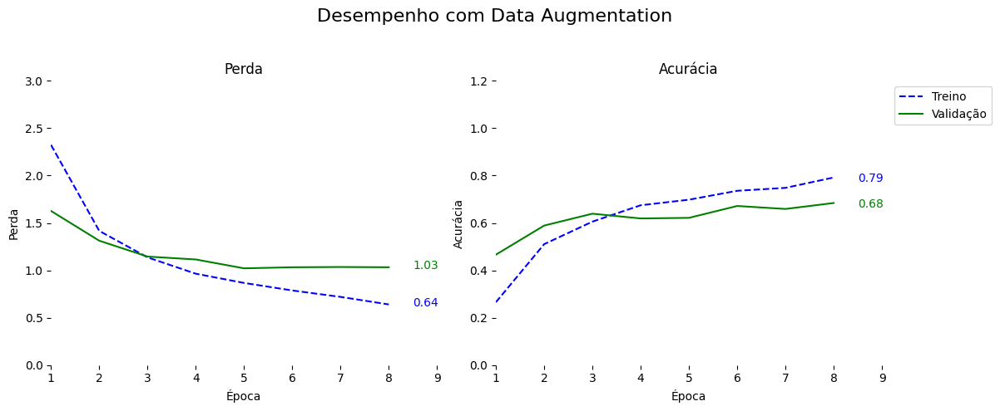

In [ ]:
# Plotar gráficos do histórico de treino
plotar_historico(history_com_aug, titulo="Desempenho com Data Augmentation")

## GRÁFICO ESQUERDA (PERDA)
# Eixo Y (vertical): Valor da perda (loss), que representa o erro do modelo:
# Quanto menor, melhor.
# Se a perda de treino diminui, mas a perda de validação não acompanha (ou piora), indica overfitting.

## GRÁFICO DA DIREITA (ACURÁCIA)
# Eixo Y (vertical): Acurácia, que mede a proporção de previsões corretas:
# Quanto maior, melhor.

### Matriz de Confusão
**Objetivo:** Avaliar o desempenho do seu modelo de classificação das equipes de Fórmula 1. A matriz de confusão permite visualizar onde o modelo acerta e, principalmente, onde ele erra — ou seja, quais classes estão sendo confundidas.

In [ ]:
# Gera previsões no conjunto de validação
val_gen_com_aug.reset()
preds = model_com_aug.predict(val_gen_com_aug, verbose=1)

# Converte as probabilidades em classes (índice da maior probabilidade)
y_pred = np.argmax(preds, axis=1)

# Verdadeiros rótulos do conjunto de validação
y_true = val_gen_com_aug.classes

# Nomes das classes
class_labels = list(val_gen_com_aug.class_indices.keys())

# Calcula a matriz de confusão
cm = confusion_matrix(y_true, y_pred)


10/10 ━━━━━━━━━━━━━━━━━━━━ 15s 1s/step


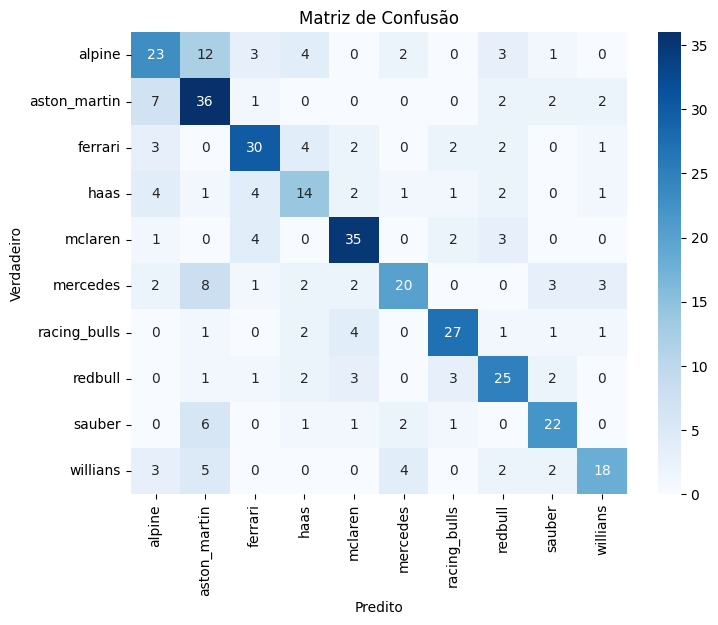

In [ ]:
# Plota a matriz de confusão
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.title('Matriz de Confusão')
plt.xlabel('Predito')
plt.ylabel('Verdadeiro')
plt.show()

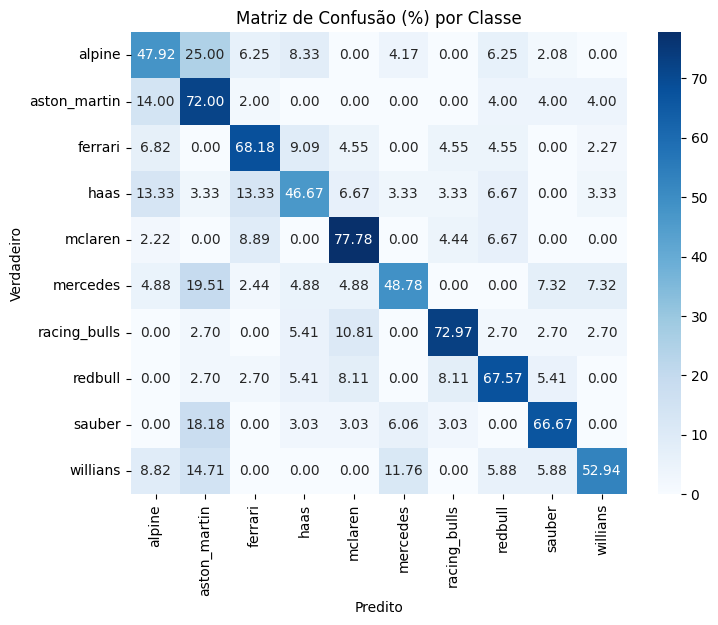

In [ ]:
cm_percent = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100

plt.figure(figsize=(8, 6))
sns.heatmap(cm_percent, annot=True, fmt='.2f', cmap='Blues',
            xticklabels=class_labels, yticklabels=class_labels)

plt.title('Matriz de Confusão (%) por Classe')
plt.xlabel('Predito')
plt.ylabel('Verdadeiro')
plt.show()

In [ ]:
# Garante que o gerador está reiniciado para garantir a ordem dos dados
val_gen_com_aug.reset()

# Caminhos das imagens do gerador de validação
image_paths = val_gen_com_aug.filepaths  # ou val_gen_com_aug.filenames (se filepaths não existir)

# Confere se image_paths tem o mesmo tamanho que y_true e y_pred
print(len(image_paths), len(y_true), len(y_pred))

# Cria um DataFrame para organizar
df_results = pd.DataFrame({
    'Imagem': image_paths,
    'Verdadeiro': y_true,
    'Predito': y_pred
})

# Mapeia os índices para os nomes das classes para facilitar visualização
df_results['Verdadeiro_Label'] = df_results['Verdadeiro'].map(lambda x: class_labels[x])
df_results['Predito_Label'] = df_results['Predito'].map(lambda x: class_labels[x])

# Filtra somente os erros
erros = df_results[df_results['Verdadeiro'] != df_results['Predito']]

# Visualiza os primeiros erros
erros[['Imagem', 'Verdadeiro_Label', 'Predito_Label']]


399 399 399


,Imagem,Verdadeiro_Label,Predito_Label
0,/content/drive/MyDrive/4º Período/Tópicos Es...,alpine,haas
3,/content/drive/MyDrive/4º Período/Tópicos Es...,alpine,mercedes
5,/content/drive/MyDrive/4º Período/Tópicos Es...,alpine,haas
7,/content/drive/MyDrive/4º Período/Tópicos Es...,alpine,aston_martin
9,/content/drive/MyDrive/4º Período/Tópicos Es...,alpine,aston_martin
...,...,...,...
385,/content/drive/MyDrive/4º Período/Tópicos Es...,willians,mercedes
389,/content/drive/MyDrive/4º Período/Tópicos Es...,willians,mercedes
390,/content/drive/MyDrive/4º Período/Tópicos Es...,willians,alpine
391,/content/drive/MyDrive/4º Período/Tópicos Es...,willians,mercedes


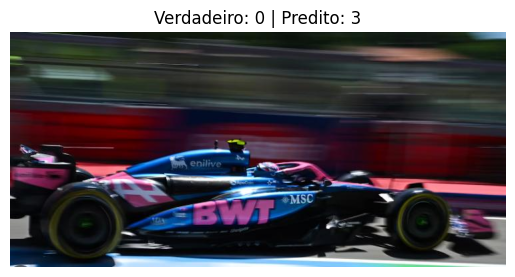

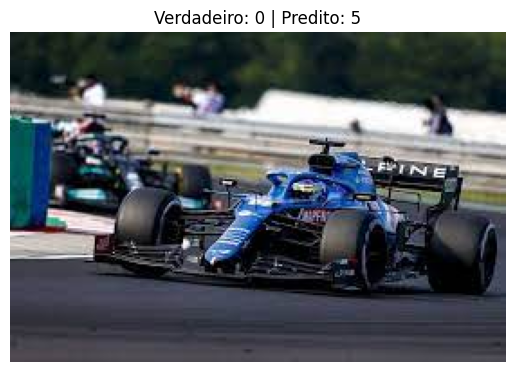

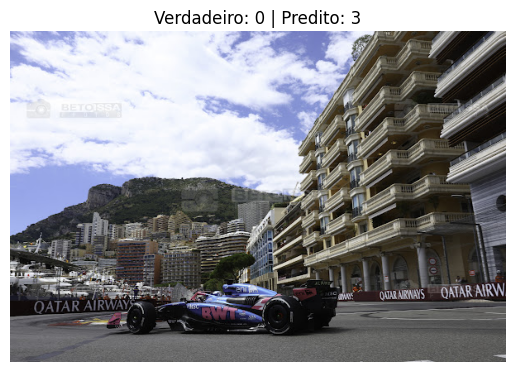

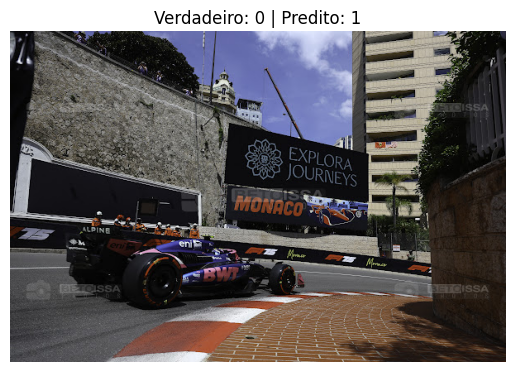

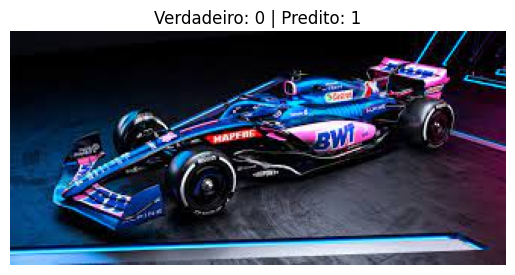

...

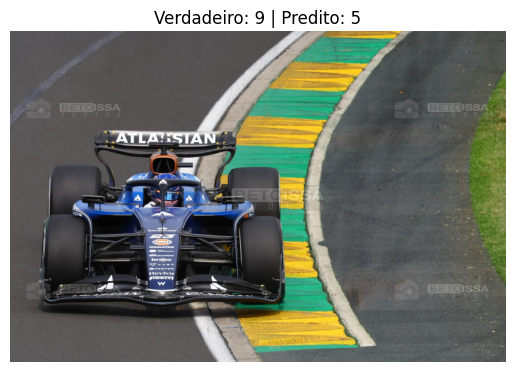

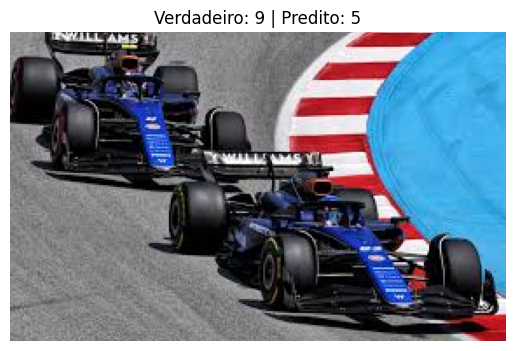

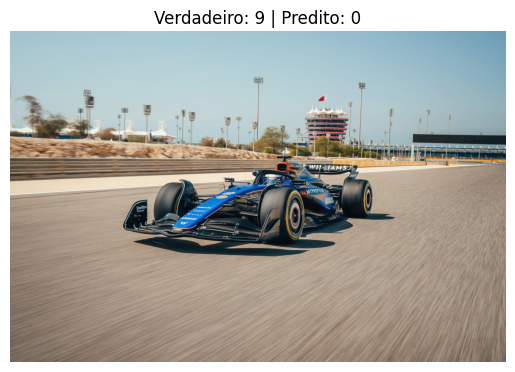

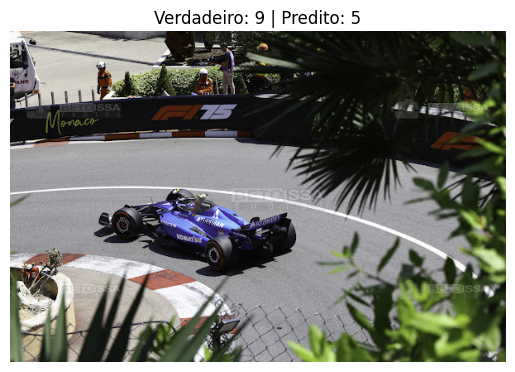

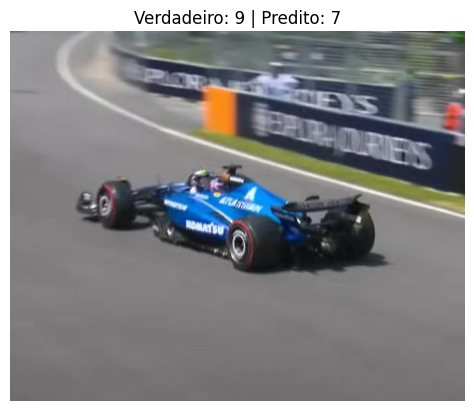

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

for index, row in erros.iterrows():
    img = mpimg.imread(row['Imagem'])
    plt.imshow(img)
    plt.title(f"Verdadeiro: {row['Verdadeiro']} | Predito: {row['Predito']}")
    plt.axis('off')
    plt.show()


### Métricas
**Objetivo:**  O relatório de métricas (precision, recall, f1-score e accuracy) quantifica a qualidade das previsões.

In [ ]:
# Gera relatório de classificação (precisão, recall, f1-score)
report = classification_report(y_true, y_pred, target_names=class_labels)
print(report)

              precision    recall  f1-score   support

      alpine       0.53      0.48      0.51        48
aston_martin       0.51      0.72      0.60        50
     ferrari       0.68      0.68      0.68        44
        haas       0.48      0.47      0.47        30
     mclaren       0.71      0.78      0.74        45
    mercedes       0.69      0.49      0.57        41
racing_bulls       0.75      0.73      0.74        37
     redbull       0.62      0.68      0.65        37
      sauber       0.67      0.67      0.67        33
    willians       0.69      0.53      0.60        34

    accuracy                           0.63       399
   macro avg       0.64      0.62      0.62       399
weighted avg       0.63      0.63      0.62       399



### 🔍 Análise dos Resultados

---
# 🚀 Hands ON! Classificando e identificando novos veículos

Classes detectadas: ['alpine', 'aston_martin', 'ferrari', 'haas', 'mclaren', 'mercedes', 'racing_bulls', 'redbull', 'sauber', 'willians']
Modelo carregado com sucesso.
Total de imagens para classificar: 1
Imagens encontradas: ['Captura de tela 2025-06-16 213504.png']


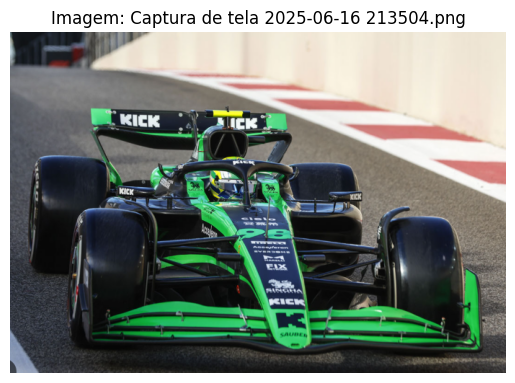

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
Captura de tela 2025-06-16 213504.png → alpine
Imagem 'Captura de tela 2025-06-16 213504.png' classificada como 'alpine'


In [ ]:
# Caminhos
CAMINHO_MODELO = Path('/content/drive/MyDrive/4º Período/Tópicos Especiais - Visão Computacional/Projeto - VC/melhor_modelo_f1.keras')
CAMINHO_NOVAS = Path('/content/drive/MyDrive/4º Período/Tópicos Especiais - Visão Computacional/Projeto - VC/novas_imagens')
CAMINHO_SAIDA = Path('/content/drive/MyDrive/4º Período/Tópicos Especiais - Visão Computacional/Projeto - VC/imagens_classificadas')
CAMINHO_CLASSES = Path('/content/drive/MyDrive/4º Período/Tópicos Especiais - Visão Computacional/Projeto - VC/imagens_equipes')

# Parâmetros do modelo
IMG_SIZE = (224, 224)  # ajuste aqui se usar outro tamanho
EXTENSOES_VALIDAS = {'.jpg', '.jpeg', '.png', '.webp'}

# Carrega classes automaticamente
class_names = obter_classes(CAMINHO_CLASSES)
print(f"Classes detectadas: {class_names}")

# Carrega modelo
modelo = load_model(str(CAMINHO_MODELO))
print("Modelo carregado com sucesso.")

# Filtra as imagens válidas
imagens_validas = [f for f in CAMINHO_NOVAS.iterdir() if f.suffix.lower() in EXTENSOES_VALIDAS]
print(f"Total de imagens para classificar: {len(imagens_validas)}")
print("Imagens encontradas:", [img.name for img in imagens_validas])

# Processa imagens novas
for arquivo in imagens_validas:
    classificacao = classificar_e_mover(modelo, class_names, arquivo, CAMINHO_SAIDA, mostrar_imagem=True)
    if classificacao is not None:
        print(f"Imagem '{arquivo.name}' classificada como '{classificacao}'")